# Face Detector

In [1]:
from pathlib import Path
import pandas as pd
import re
from PIL import Image
import cv2 as cv
import numpy as np
cv.__version__

'4.6.0'

In [2]:
from tqdm.auto import tqdm
tqdm.pandas()

In [3]:
dataset_v1 = Path('/s/babbage/b/nobackup/nblancha/public-datasets/bold5000')
dataset_v2 = Path('/s/babbage/b/nobackup/nblancha/public-datasets/bold5000r2')

In [4]:
def get_dataset(image_name):
    if re.match(r'^n[0-9]+', image_name):
        return 'ImageNet'
    elif re.match(r'^COCO', image_name):
        return 'COCO'
    else:
        return 'Scene'

## Gather all Stimuli

In [5]:
stim_dir = dataset_v2 / 'BOLD5000_Stimuli' / 'Scene_Stimuli' / 'Presented_Stimuli'
img_path_list = list(stim_dir.glob('**/*.[jJ][pP]*[gG]'))

# Check list length
assert len(img_path_list) == 4916

In [6]:
# Create dataframe to hold our metada
img_df = pd.DataFrame(img_path_list, columns = ['path'])
# Extract filename from path
img_df['image'] = img_df.path.map(lambda p: p.name)
# OpenCV can't handle Path objects, so conver to str
img_df['path'] = img_df.path.map(str)
img_df['dataset'] = img_df.image.map(get_dataset)

In [7]:
img_df

,path,image,dataset
0,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000338169.jpg,COCO
1,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000100223.jpg,COCO
2,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000273771.jpg,COCO
3,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000323936.jpg,COCO
4,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000119669.jpg,COCO
...,...,...,...
4911,/s/babbage/b/nobackup/nblancha/public-datasets...,drymountains6.jpg,Scene
4912,/s/babbage/b/nobackup/nblancha/public-datasets...,olympicswimmingpool7.jpg,Scene
4913,/s/babbage/b/nobackup/nblancha/public-datasets...,hotelRoom2.jpg,Scene
4914,/s/babbage/b/nobackup/nblancha/public-datasets...,planetarium1.jpg,Scene


## Detect Faces

In [8]:
modelFile = "models/res10_300x300_ssd_iter_140000_fp16.caffemodel"
configFile = "models/deploy.prototxt"
net = cv.dnn.readNet(modelFile, configFile)

In [9]:
def detect_face(path, threshold=0.5, net=net):
    # Load image
    img = cv.imread(path)
    height = img.shape[0]
    width = img.shape[1]
    
    # Preprocess image
    blob = cv.dnn.blobFromImage(
        image=img,
        scalefactor=1.0,
        size=(300, 300),
        mean=[104, 117, 123],
        swapRB=False,
        crop=False
    )

    # Perform inference
    net.setInput(blob)
    detections = net.forward()
    
    # Only save face with confidence over threshold
    faces = []
    for face in detections[0, 0, :]:
        confidence = face[2]
        if confidence > threshold:
            x1 = int(face[3] * width)
            y1 = int(face[4] * height)
            x2 = int(face[5] * width)
            y2 = int(face[6] * height)
            faces.append((confidence, x1, y1, x2, y2))
    
    # None is easier to detect in a Dataframe than an empty list
    if len(faces) == 0:
        faces = None
                
    return faces

In [10]:
img_df['faces'] = img_df.path.progress_apply(detect_face, threshold=.5)

  0%|          | 0/4916 [00:00<?, ?it/s]

In [11]:
img_df

,path,image,dataset,faces
0,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000338169.jpg,COCO,None
1,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000100223.jpg,COCO,None
2,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000273771.jpg,COCO,None
3,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000323936.jpg,COCO,None
4,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000119669.jpg,COCO,None
...,...,...,...,...
4911,/s/babbage/b/nobackup/nblancha/public-datasets...,drymountains6.jpg,Scene,None
4912,/s/babbage/b/nobackup/nblancha/public-datasets...,olympicswimmingpool7.jpg,Scene,None
4913,/s/babbage/b/nobackup/nblancha/public-datasets...,hotelRoom2.jpg,Scene,None
4914,/s/babbage/b/nobackup/nblancha/public-datasets...,planetarium1.jpg,Scene,None


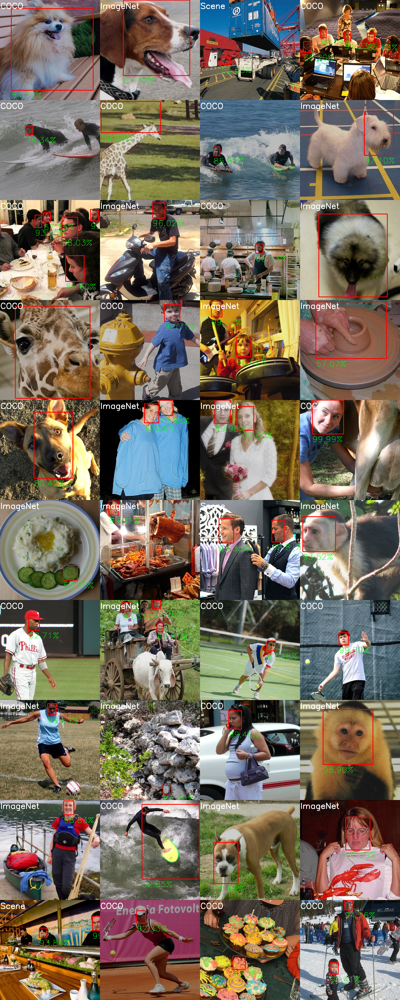

In [15]:
# Helper functions
def show_bgr(img): 
    return Image.fromarray(img[:,:,::-1])

def show_blob(blob):
    return Image.fromarray(blob[0].transpose(1,2,0).astype('uint8'))

def get_detect_img(stimulus):
    img = cv.imread(str(stimulus.path))
    
    for face in stimulus.faces:
        confidence, x1, y1, x2, y2 = face
        cv.rectangle(img,(x1,y1),(x2,y2),(0, 0, 255),2)
        cv.putText(img, f'{confidence:2.2%}', (x1, y2+30), cv.FONT_HERSHEY_SIMPLEX, 1, (0,255,0), 1, 1, bottomLeftOrigin=False)
    
    cv.putText(img, f'{stimulus.dataset}', (1, 32), cv.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    return img

# Get random sample
sample = img_df[img_df.faces.isna() == False].sample(40)

rows=[]
for row in range(10):
    cols=[]
    for col in range(4):
        cols.append(get_detect_img(sample.iloc[row * 4 + col]))
    rows.append(np.hstack(cols))
collage = np.vstack(rows)

show_bgr(collage)

In [16]:
img_df.to_pickle('face-detection-df.pkl')

## Old Detect Faces

https://github.com/opencv/opencv_zoo/tree/master/models/face_detection_yunet

In [168]:
# Helper functions
def show_bgr(img): 
    return Image.fromarray(img[:,:,::-1])

def show_blob(blob):
    return Image.fromarray(blob[0].transpose(1,2,0).astype('uint8'))

# def get_detect_img(face):
#     img = cv2.imread(str(face.path))
#     cv2.rectangle(img,(face.x1,face.y1),(face.x2,face.y2),(0, 0, 255),2)
#     cv2.putText(img, f'{face.confidence:2.2%}', (face.x1, face.y2+15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1, 1, bottomLeftOrigin=False)
#     return img

def get_detect_img(face):
    img = cv.imread(str(face.path))
    
    for face in face.detections[0,0,:]:
        confidence = face[2]

        # Calculate bounding box
        height = img.shape[0]
        width = img.shape[1]
        # Adjust for crop width
        inv_ratio = height/width
        w_off = (width/height - 1) / 2
        x1 = int((face[3] + w_off) * inv_ratio * width)
        y1 = int(face[4] * height)
        x2 = int((face[5] + w_off) * inv_ratio * width)
        y2 = int(face[6] * height)
        cv.rectangle(img,(x1,y1),(x2,y2),(0, 0, 255),2)
        cv.putText(img, f'{confidence:2.2%}', (x1, y2+15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1, 1, bottomLeftOrigin=False)
    return img

def show_detect(face):
    img = get_detect_img(face)
    return show_bgr(img)

In [46]:
detector = cv.FaceDetectorYN.create(
    'models/face_detection_yunet_2022mar.onnx',
    "",
    (320,320)
)

In [84]:
img = cv.imread(str(img_df.sample().iloc[-1].path))
h, w, _ = img.shape
detector.setInputSize((w, h))
faces = detector.detect(img)

In [85]:
faces

(1, None)

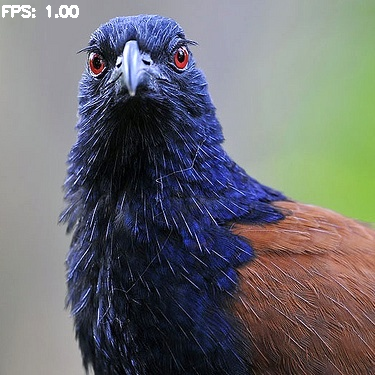

In [86]:
show_bgr(visualize(img, faces, 1))

### Test Image Preprocessing

In [52]:
img_df.sample().iloc[-1].path

PosixPath('/s/babbage/b/nobackup/nblancha/public-datasets/bold5000r2/BOLD5000_Stimuli/Scene_Stimuli/Presented_Stimuli/COCO/COCO_train2014_000000065029.jpg')

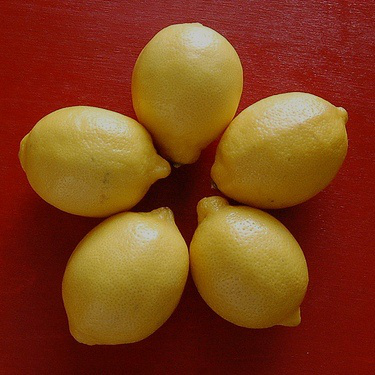

In [70]:
# Test image preprocessing
# Load random image
img = cv2.imread(str(img_df.sample().iloc[-1].path))
show_bgr(img)

In [71]:
img.shape

(375, 375, 3)

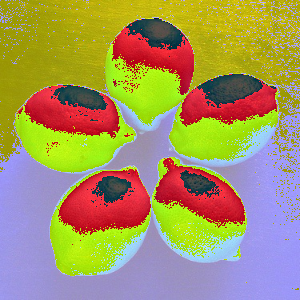

In [72]:
# Preprocess image
blob = cv2.dnn.blobFromImage(image=img, 
                             scalefactor=1.0, 
                             size=(300, 300), 
                             mean=[104, 117, 123], 
                             swapRB=False, 
                             crop=True)
show_blob(blob)

In [57]:
blob.shape

(1, 3, 300, 300)

### Run Model

In [148]:
# # Define our model globally so we don't have to keep reloading it
# modelFile = "../first-impressions/models/opencv_face_detector_uint8.pb"
# configFile = "../first-impressions/models/opencv_face_detector.pbtxt"
# net = cv2.dnn.readNetFromTensorflow(modelFile, configFile)

# def detect_face(path, net=net):
#     # Load image
#     img = cv2.imread(str(path))
    
#     # Preprocess image
#     blob = cv2.dnn.blobFromImage(image=img, 
#                                  scalefactor=1.0, 
#                                  size=(300, 300), 
#                                  mean=[104, 117, 123], 
#                                  swapRB=False, 
#                                  crop=False)

    
#     # Perform inference
#     net.setInput(blob)
#     detections = net.forward()
    
#     # Get best detection (detections are presorted by confidence)
#     best_det = detections[0,0,0]
#     confidence = best_det[2]

#     # Calculate bounding box
#     height = img.shape[0]
#     width = img.shape[1]
#     # Adjust for crop width
#     inv_ratio = height/width
#     w_off = (width/height - 1) / 2
#     x1 = int((best_det[3] + w_off) * inv_ratio * width)
#     y1 = int(best_det[4] * height)
#     x2 = int((best_det[5] + w_off) * inv_ratio * width)
#     y2 = int(best_det[6] * height)

#     return confidence, x1, y1, x2, y2

def detect_face(path):
    detector = cv.FaceDetectorYN.create(
        'models/face_detection_yunet_2022mar.onnx',
        "",
        (320,320),
        t
    )
    
    img = cv.imread(path)
    h, w, _ = img.shape
    area = h * w
    # OpenCV DNN automagically handles size???
    detector.setInputSize((w, h))
    _, faces = detector.detect(img)
    
    too_small = []
    if faces is not None:
        for idx, face in enumerate(faces):
            coords = face[:-1].astype(np.int32)
            face_area = coords[2] * coords[3]
            if face_area < (area * .05):
                print(f'Face too small: {face_area}, {face_area / area * 100}%')
                too_small.append(idx)
                
        faces = np.delete(faces, too_small, axis=0)
        if faces.size == 0:
            faces = None
    
    return faces;

In [149]:
detect_face(img_df.sample().iloc[-1].path)

In [150]:
img_df['faces'] = img_df.path.progress_apply(detect_face).to_list()

  0%|          | 0/4916 [00:00<?, ?it/s]

Face too small: 2714, 1.9299555555555556%
Face too small: 462, 0.32853333333333334%
Face too small: 224, 0.1592888888888889%
Face too small: 768, 0.5461333333333334%
Face too small: 224, 0.1592888888888889%
Face too small: 4543, 3.230577777777778%
Face too small: 4880, 3.4702222222222225%
Face too small: 4015, 2.855111111111111%
Face too small: 5917, 4.207644444444444%
Face too small: 9592, 6.820977777777777%
Face too small: 12090, 8.597333333333333%
Face too small: 616, 0.43804444444444446%
Face too small: 156, 0.11093333333333333%
Face too small: 1008, 0.7168%
Face too small: 460, 0.3271111111111111%
Face too small: 224, 0.1592888888888889%
Face too small: 156, 0.11093333333333333%
Face too small: 120, 0.08533333333333333%
Face too small: 3195, 2.2720000000000002%
Face too small: 2376, 1.6896000000000002%
Face too small: 117, 0.0832%
Face too small: 8568, 6.0928%
Face too small: 1054, 0.7495111111111111%
Face too small: 224, 0.1592888888888889%
Face too small: 224, 0.1592888888888889

## Save Face Detections

In [94]:
img_df

,path,image,dataset,faces
0,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000338169.jpg,COCO,None
1,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000100223.jpg,COCO,None
2,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000273771.jpg,COCO,None
3,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000323936.jpg,COCO,None
4,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000119669.jpg,COCO,None
...,...,...,...,...
4911,/s/babbage/b/nobackup/nblancha/public-datasets...,drymountains6.jpg,Scene,None
4912,/s/babbage/b/nobackup/nblancha/public-datasets...,olympicswimmingpool7.jpg,Scene,None
4913,/s/babbage/b/nobackup/nblancha/public-datasets...,hotelRoom2.jpg,Scene,None
4914,/s/babbage/b/nobackup/nblancha/public-datasets...,planetarium1.jpg,Scene,None


### Random Collage of Face Detections

In [152]:
def visualize(stimulus, thickness=2):
    img = cv.imread(stimulus.path)
    if stimulus.faces is not None:
        for idx, face in enumerate(stimulus.faces):
            print('Face {}, top-left coordinates: ({:.0f}, {:.0f}), box width: {:.0f}, box height {:.0f}, score: {:.2f}'.format(idx, face[0], face[1], face[2], face[3], face[-1]))

            coords = face[:-1].astype(np.int32)
            cv.rectangle(img, (coords[0], coords[1]), (coords[0]+coords[2], coords[1]+coords[3]), (0, 255, 0), thickness)
            cv.circle(img, (coords[4], coords[5]), 2, (255, 0, 0), thickness)
            cv.circle(img, (coords[6], coords[7]), 2, (0, 0, 255), thickness)
            cv.circle(img, (coords[8], coords[9]), 2, (0, 255, 0), thickness)
            cv.circle(img, (coords[10], coords[11]), 2, (255, 0, 255), thickness)
            cv.circle(img, (coords[12], coords[13]), 2, (0, 255, 255), thickness)
            cv.putText(img, f'{face[-1]:2.2%}', (coords[0], coords[1]+coords[3]+15), cv.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1, 1, bottomLeftOrigin=False)
    cv.putText(img, f'{stimulus.dataset}', (1, 32), cv.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    return img

In [153]:
img_df.faces.isna()

0       True
1       True
2       True
3       True
4       True
        ... 
4911    True
4912    True
4913    True
4914    True
4915    True
Name: faces, Length: 4916, dtype: bool

Face 0, top-left coordinates: (78, 13), box width: 228, box height 256, score: 0.98
Face 0, top-left coordinates: (215, 32), box width: 116, box height 186, score: 1.00
Face 0, top-left coordinates: (106, 96), box width: 163, box height 168, score: 1.00
Face 0, top-left coordinates: (98, 104), box width: 172, box height 202, score: 0.99
Face 0, top-left coordinates: (7, 27), box width: 252, box height 293, score: 1.00
Face 0, top-left coordinates: (162, 86), box width: 122, box height 159, score: 1.00
Face 0, top-left coordinates: (-2, 28), box width: 115, box height 147, score: 1.00
Face 0, top-left coordinates: (134, 32), box width: 167, box height 185, score: 1.00
Face 0, top-left coordinates: (177, 93), box width: 160, box height 179, score: 1.00
Face 0, top-left coordinates: (79, 0), box width: 163, box height 146, score: 0.95
Face 0, top-left coordinates: (84, 142), box width: 182, box height 178, score: 0.94
Face 0, top-left coordinates: (10, 2), box width: 259, box height 291, 

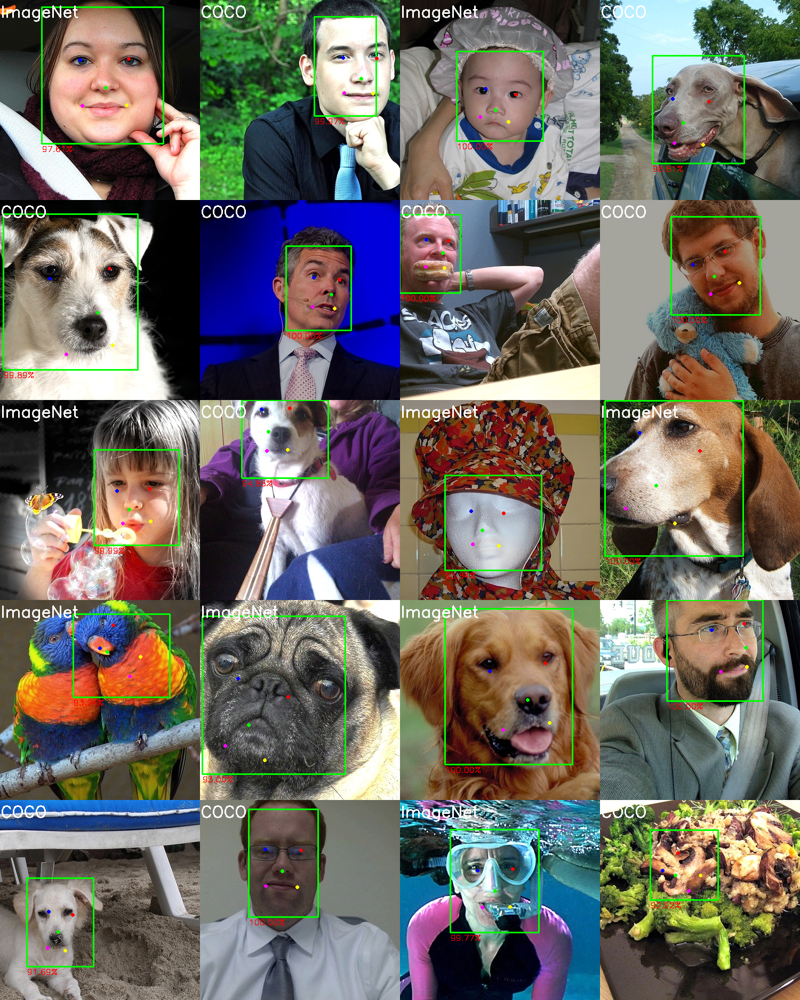

In [154]:
# Get random sample
sample = img_df[img_df.faces.isna() == False].sample(20)

rows=[]
for row in range(5):
    cols=[]
    for col in range(4):
        cols.append(visualize(sample.iloc[row * 4 + col]))
    rows.append(np.hstack(cols))
collage = np.vstack(rows)

show_bgr(collage)

In [101]:
img_df.faces.notna().sum()

950

In [151]:
img_df.faces.notna().sum()

167

In [155]:
!wget -P models/ https://raw.githubusercontent.com/opencv/opencv_3rdparty/dnn_samples_face_detector_20180205_fp16/res10_300x300_ssd_iter_140000_fp16.caffemodel

--2022-10-07 14:35:15--  https://raw.githubusercontent.com/opencv/opencv_3rdparty/dnn_samples_face_detector_20180205_fp16/res10_300x300_ssd_iter_140000_fp16.caffemodel
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5351047 (5.1M) [application/octet-stream]
Saving to: ‘models/res10_300x300_ssd_iter_140000_fp16.caffemodel’

res10_300x300_ssd_i 100%[===================>]   5.10M  --.-KB/s    in 0.06s   

2022-10-07 14:35:16 (80.6 MB/s) - ‘models/res10_300x300_ssd_iter_140000_fp16.caffemodel’ saved [5351047/5351047]



In [156]:
!wget -P models/ https://raw.githubusercontent.com/opencv/opencv/4.x/samples/dnn/face_detector/deploy.prototxt

--2022-10-07 14:39:58--  https://raw.githubusercontent.com/opencv/opencv/4.x/samples/dnn/face_detector/deploy.prototxt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 28104 (27K) [text/plain]
Saving to: ‘models/deploy.prototxt’

deploy.prototxt     100%[===================>]  27.45K  --.-KB/s    in 0s      

2022-10-07 14:39:58 (109 MB/s) - ‘models/deploy.prototxt’ saved [28104/28104]



In [219]:
img_df.detections.notna().sum()

937

In [208]:
img_df[img_df.detections.isna() == False].sample(40)

,path,image,dataset,faces,detections
3329,/s/babbage/b/nobackup/nblancha/public-datasets...,n04099969_3551.JPEG,ImageNet,None,"[(0.91705096, 193, 35, 255, 121)]"
2217,/s/babbage/b/nobackup/nblancha/public-datasets...,n03980874_15861.JPEG,ImageNet,None,"[(0.9995703, 151, 22, 217, 101)]"
2932,/s/babbage/b/nobackup/nblancha/public-datasets...,n02114367_15682.JPEG,ImageNet,None,"[(0.96956575, 242, 9, 328, 134)]"
543,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000009987.jpg,COCO,None,"[(0.78829724, 98, 135, 125, 170)]"
345,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000195027.jpg,COCO,None,"[(0.9999484, 188, 71, 272, 176)]"
2727,/s/babbage/b/nobackup/nblancha/public-datasets...,n03792782_5959.JPEG,ImageNet,None,"[(0.69283396, 194, 61, 223, 95)]"
3442,/s/babbage/b/nobackup/nblancha/public-datasets...,n02895154_28027.JPEG,ImageNet,None,"[(0.9102436, 245, 127, 304, 216), (0.6418835, ..."
2006,/s/babbage/b/nobackup/nblancha/public-datasets...,n03724870_15531.JPEG,ImageNet,None,"[(0.71980166, 193, 138, 375, 375)]"
759,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000440334.jpg,COCO,None,"[(0.5383812, 150, 267, 216, 370)]"
452,/s/babbage/b/nobackup/nblancha/public-datasets...,COCO_train2014_000000315994.jpg,COCO,None,"[(0.57062167, 111, 110, 159, 143)]"


In [226]:
net.getLayerNames()

('data_bn',
 'data_scale',
 'conv1_h',
 'conv1_bn_h',
 'conv1_scale_h',
 'conv1_relu',
 'conv1_pool',
 'layer_64_1_conv1_h',
 'layer_64_1_bn2_h',
 'layer_64_1_scale2_h',
 'layer_64_1_relu2',
 'layer_64_1_conv2_h',
 'layer_64_1_sum',
 'layer_128_1_bn1_h',
 'layer_128_1_scale1_h',
 'layer_128_1_relu1',
 'layer_128_1_conv1_h',
 'layer_128_1_bn2',
 'layer_128_1_scale2',
 'layer_128_1_relu2',
 'layer_128_1_conv2',
 'layer_128_1_conv_expand_h',
 'layer_128_1_sum',
 'layer_256_1_bn1',
 'layer_256_1_scale1',
 'layer_256_1_relu1',
 'layer_256_1_conv1',
 'layer_256_1_bn2',
 'layer_256_1_scale2',
 'layer_256_1_relu2',
 'layer_256_1_conv2',
 'layer_256_1_conv_expand',
 'layer_256_1_sum',
 'layer_512_1_bn1',
 'layer_512_1_scale1',
 'layer_512_1_relu1',
 'layer_512_1_conv1_h',
 'layer_512_1_bn2_h',
 'layer_512_1_scale2_h',
 'layer_512_1_relu2',
 'layer_512_1_conv2_h',
 'layer_512_1_conv_expand_h',
 'layer_512_1_sum',
 'last_bn_h',
 'last_scale_h',
 'last_relu',
 'conv6_1_h',
 'conv6_1_relu',
 'conv6

In [233]:
layer = net.getLayer('conv6_1_h') 

In [234]:
layer

< cv2.dnn.Layer 0x7f2c0525e5d0>

In [235]:
layer.type

'Convolution'

In [236]:
layer.blobs

(array([[[[-0.00018799]],
 
         [[-0.00706863]],
 
         [[-0.01103973]],
 
         ...,
 
         [[-0.0111618 ]],
 
         [[ 0.00277901]],
 
         [[ 0.11816406]]],
 
 
        [[[-0.00468063]],
 
         [[-0.00735092]],
 
         [[-0.01019287]],
 
         ...,
 
         [[-0.02696228]],
 
         [[-0.00714111]],
 
         [[-0.04418945]]],
 
 
        [[[ 0.0085907 ]],
 
         [[-0.00344849]],
 
         [[ 0.00106525]],
 
         ...,
 
         [[ 0.00647354]],
 
         [[ 0.00426865]],
 
         [[ 0.01100159]]],
 
 
        ...,
 
 
        [[[-0.01242065]],
 
         [[-0.00452042]],
 
         [[-0.01157379]],
 
         ...,
 
         [[ 0.01489258]],
 
         [[-0.01018524]],
 
         [[-0.04977417]]],
 
 
        [[[-0.00452423]],
 
         [[-0.00248718]],
 
         [[ 0.01269531]],
 
         ...,
 
         [[ 0.00201988]],
 
         [[-0.00222969]],
 
         [[-0.00399017]]],
 
 
        [[[-0.00100708]],
 
         [[-0.000899

In [ ]:
layer.